[PosixPath('/home/dtsai/Data/victis_datasets/coral_tab_image/3230-8-1-5-0-240118-1626_tab01_original_size.jpg'), PosixPath('/home/dtsai/Data/victis_datasets/coral_tab_image/CGRAS_Amag_241112_T14_01_patch01_original_size.jpg')]
/home/dtsai/Data/victis_datasets/coral_tab_image/3230-8-1-5-0-240118-1626_tab01_original_size.jpg


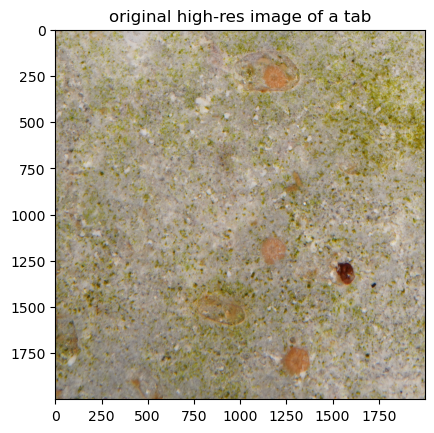

In [15]:
# coral counting/assessment using cgras model as proof-of-concept

# try slicing up image using SAHI
from sahi import AutoDetectionModel
# from sahi.utils.cv import read_image
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

out_dir = './output'
# test image:
img_dir = '/home/dtsai/Data/victis_datasets/coral_tab_image'
img_list = sorted(Path(img_dir).rglob('*.jpg'))
print(img_list)

img_name = str(img_list[0])

print(img_name)
img = cv.imread(img_name)
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plt.figure()
plt.imshow(img)
plt.title('original high-res image of a tab')
plt.show()

# following the example: https://github.com/obss/sahi/blob/main/demo/inference_for_ultralytics.ipynb
model_path = '/home/dtsai/Data/victis_datasets/coral_detection_model/20240206_cgras_best.pt'
detection_model = AutoDetectionModel.from_pretrained(
    model_type='ultralytics',
    model_path = model_path,
    confidence_threshold=0.1,
    device='cpu'
)


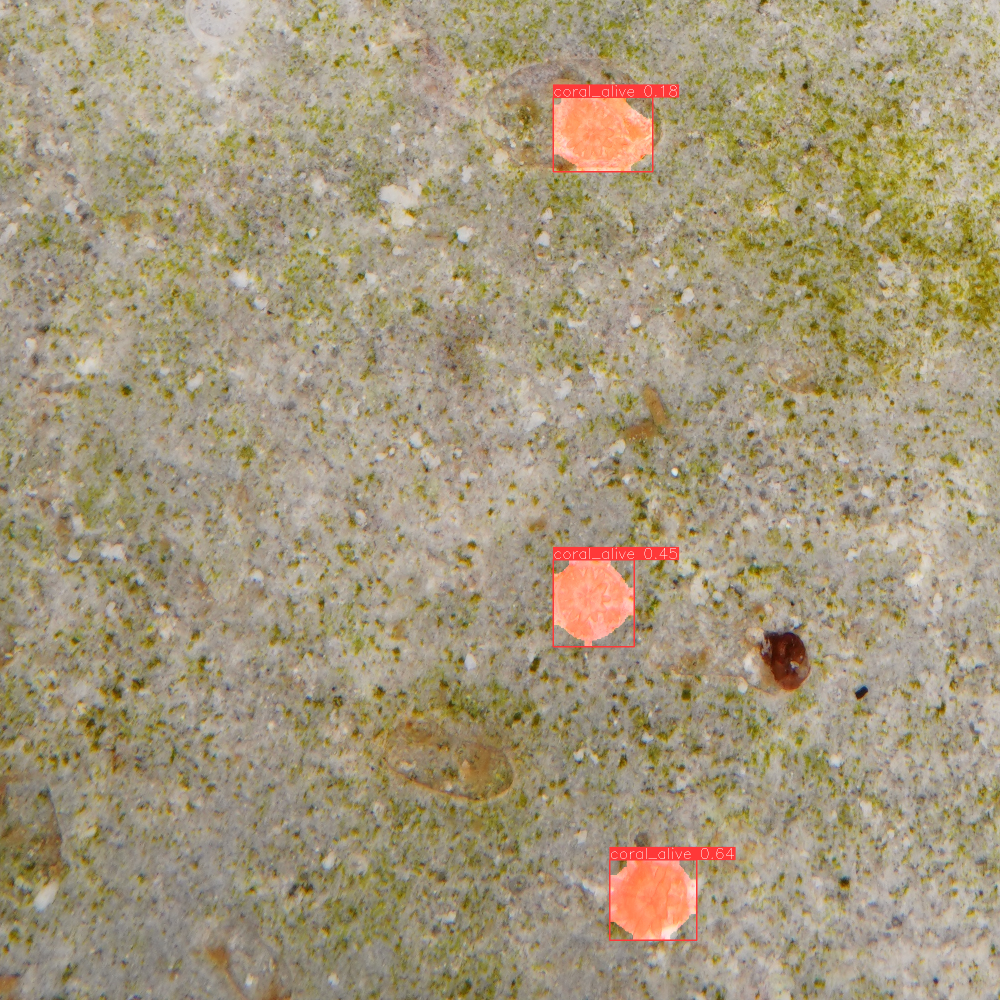

In [21]:
# get result with no slicing - just whole-image prediction

result = get_prediction(image=img_name, detection_model=detection_model)

result.export_visuals(export_dir=out_dir, hide_conf=False, text_size=1, rect_th=2)

Image('output/prediction_visual.png')



Obviously, we're missing some corals and the confidence is very low!

Performing prediction on 25 slices.
[PosixPath('output/slices/slice_0_0_640_640.png'), PosixPath('output/slices/slice_0_1344_640_1984.png'), PosixPath('output/slices/slice_0_1360_640_2000.png'), PosixPath('output/slices/slice_0_448_640_1088.png'), PosixPath('output/slices/slice_0_896_640_1536.png'), PosixPath('output/slices/slice_1344_0_1984_640.png'), PosixPath('output/slices/slice_1344_1344_1984_1984.png'), PosixPath('output/slices/slice_1344_1360_1984_2000.png'), PosixPath('output/slices/slice_1344_448_1984_1088.png'), PosixPath('output/slices/slice_1344_896_1984_1536.png'), PosixPath('output/slices/slice_1360_0_2000_640.png'), PosixPath('output/slices/slice_1360_1344_2000_1984.png'), PosixPath('output/slices/slice_1360_1360_2000_2000.png'), PosixPath('output/slices/slice_1360_448_2000_1088.png'), PosixPath('output/slices/slice_1360_896_2000_1536.png'), PosixPath('output/slices/slice_448_0_1088_640.png'), PosixPath('output/slices/slice_448_1344_1088_1984.png'), PosixPath('output/sli

<Figure size 640x480 with 0 Axes>

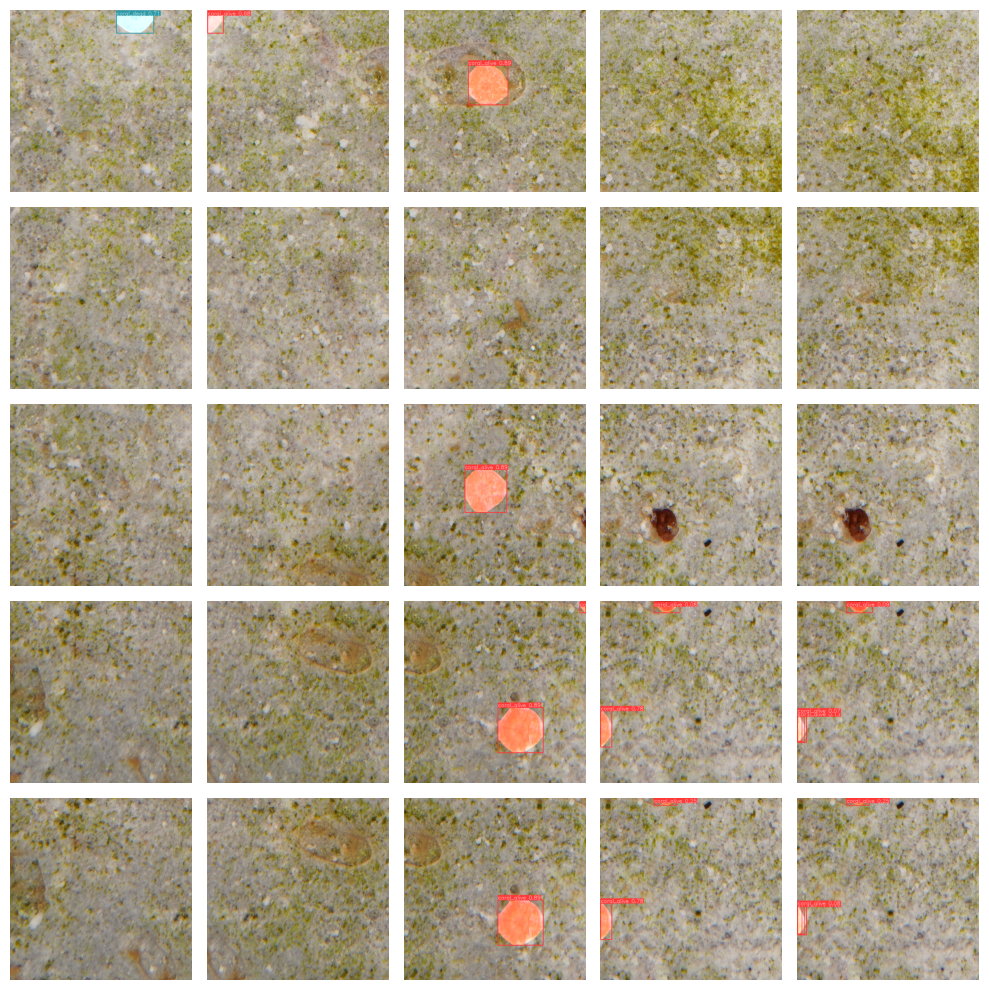

In [56]:

import os

slice_export_dir = os.path.join(out_dir, 'slices')

sliced_results = get_sliced_prediction(
    image=img_name, 
    detection_model=detection_model,
    slice_height=640,
    slice_width=640,
    overlap_height_ratio=0.3,
    overlap_width_ratio=0.3,
    postprocess_type='NMM',
    slice_dir=slice_export_dir,
    slice_export_prefix='slice')


# unfortunately, sahi doesn't have any tools to export visualisations of individual slices (as far as I can see)
# need to do predictions all over again on each set of slices
slices = sorted(Path(slice_export_dir).rglob('*.png'))
print(slices)
print(len(slices))

slice_pred_dir = os.path.join(out_dir, 'slice_predictions')

slice_filenames = []
for i, slice in enumerate(slices):
    # print(slice)
    pred_slice = get_prediction(image=str(slice), 
                                detection_model=detection_model)
    
    output_name =os.path.basename(slice)[:-4]
    print(output_name)
    pred_slice.export_visuals(export_dir=slice_pred_dir, 
                      hide_conf=False,
                      text_size=0.6,
                      rect_th=2,
                      file_name=output_name)
    slice_filenames.append(os.path.join(slice_pred_dir, output_name + '.png'))

# print/show the resultant sliced predictions in an array of images

# Function to extract coordinates from filename
def extract_coords(filename):
    filename = filename[:-4]
    parts = filename.split("_")
    if len(parts) == 5:  # Expected format: slice_x1_y1_x2_y2
        x1, y1, x2, y2 = map(int, parts[1:])
        return x1, y1, x2, y2
    return None
    
# Store slices with their coordinates
slices = []
for filename in slice_filenames:
    coords = extract_coords(os.path.basename(filename))
    if coords:
        slices.append((filename, coords))

# Sort slices by (y1, x1) so they appear in correct order
slices.sort(key=lambda x: (x[1][1], x[1][0]))

# Load images in sorted order
sorted_images = [cv.imread(filename) for filename, _ in slices]

# Determine grid size (5x5 for 25 slices)
grid_size = int(np.sqrt(len(sorted_images)))  # Assuming a square layout

print(grid_size)
# Plot slices in correct order
plt.figure()
fig, axes = plt.subplots(grid_size, grid_size, figsize=(10, 10))
axes = axes.flatten()

for i, img in enumerate(sorted_images):
    axes[i].imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    axes[i].axis("off")

plt.tight_layout()
plt.show()





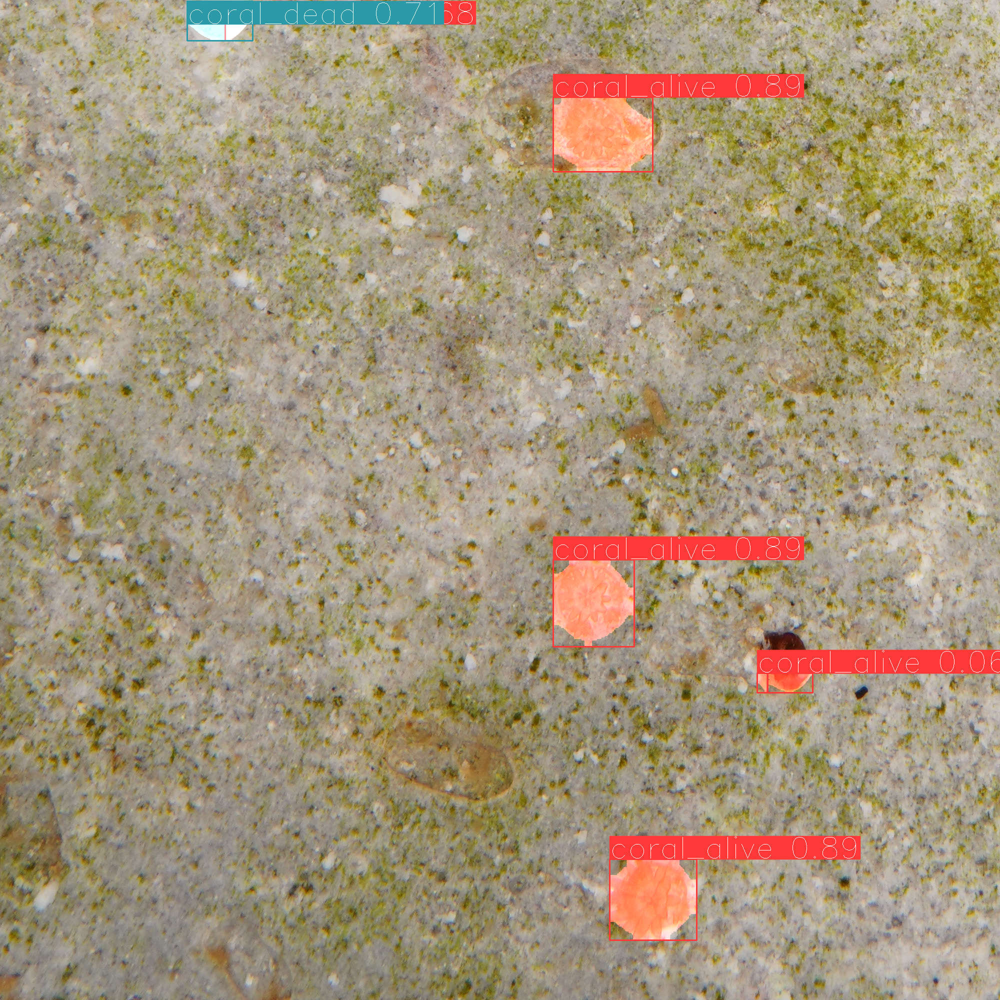

In [57]:


# TODO showcase the slicing:
# https://github.com/obss/sahi/blob/main/demo/slicing.ipynb

# from sahi.visualization import visualize_object_predictions

# slices_with_detections = []
# for slice_image_result in sliced_results.image_slices:
#     slice_image = slice_image_result.image
#     object_pred_list = slice_image_result.object_prediction_list

#     # # overlay:
#     # visualized_slice = visualize_object_predictions(
#     #     image=slice_image,
#     #     object_pred_list=object_pred_list,
#     #     rect_th=2,
#     #     text_size=1,
#     #     text_th=1
#     # )

# # arrange slices into grid
# num_slices = len(slices_with_detections)
# cols = 4
# rows = (num_slices // cols) + (num_slices % cols > 0)

# fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
# axes = axes.flatten()

# # Plot each slice
# for i in range(len(slices_with_detections)):
#     axes[i].imshow(slices_with_detections[i])
#     axes[i].axis("off")

# # Hide any empty subplots
# for j in range(i + 1, len(axes)):
#     axes[j].axis("off")

# plt.tight_layout()
# plt.show()

sliced_results.export_visuals(export_dir=out_dir, 
                      hide_conf=False,
                      text_size=2,
                      rect_th=2)

Image('output/prediction_visual.png')